# Eval runs

In [1]:
#! pip install pandas
#! pip install matplotlib
#! pip install scipy
#! pip install seaborn
#! pip install nbconvert
#! pip install matplotlib-venn
! jupyter nbconvert --to HTML QualitativeAnalysis.ipynb

[NbConvertApp] Converting notebook QualitativeAnalysis.ipynb to HTML
[NbConvertApp] WARNING | Alternative text is missing on 3 image(s).
[NbConvertApp] Writing 19651604 bytes to QualitativeAnalysis.html


In [3]:
import pandas as pd
import os
import glob
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from pathlib import Path
from PIL import Image 

pd.set_option('display.max_columns', None)

Loaded 70 misclassified entries.


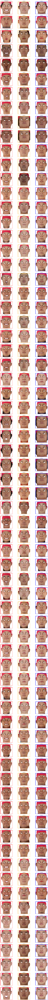

In [16]:

csv_path = "E:\\Download\\mlruns\\313193843584883898\\b240861c39ab4006a7c6f11269e830aa\\artifacts\\error_rate_per_class\\test_rgb_bff_crop_mv_misclassified_scans.csv"
dataset_folder = Path("F:\\Face\\data\\datasets9\\test_rgb_bff_crop")  # Dataset Folder
ncols = 3  # how many images per row in the plot

df = pd.read_csv(csv_path, dtype={'True Class': str, 'Predicted Class': str})
print(f"Loaded {len(df)} misclassified entries.")

n_images = len(df)
nrows = (n_images + 1) // 1  # One row per misclassified sample

nrows = min(nrows, 100)

plt.figure(figsize=(ncols * 5, nrows * 4))

for i, row in df.head(100).iterrows():
    scan_id = row["Scan ID"]
    true_class = row["True Class"]
    pred_class = row["Predicted Class"]

    # Paths
    wrong_path = dataset_folder / "validation" / str(true_class) / f"{scan_id}0_0_image.jpg"
    true_folder = dataset_folder / "train" / str(true_class)
    pred_folder = dataset_folder / "train" / str(pred_class)

    correct_img_candidates = glob.glob(str(true_folder / "*0_0_image.jpg"))
    correct_path = correct_img_candidates[0] if correct_img_candidates else None

    pred_sample_candidates = glob.glob(str(pred_folder / "*0_0_image.jpg"))
    pred_sample_path = pred_sample_candidates[0] if pred_sample_candidates else None

    try:
        # 1. Misclassified Image
        img_wrong = Image.open(wrong_path)
        ax1 = plt.subplot(nrows, ncols, i * ncols + 1)
        ax1.imshow(img_wrong)
        ax1.axis('off')
        ax1.set_title(f"Missclassified Query \nID: {scan_id}\n {true_class}", fontsize=8)
        ax1.add_patch(Rectangle((0, 0), img_wrong.size[0], img_wrong.size[1],
                                linewidth=6, edgecolor='red', facecolor='none'))

        # 2. Example from predicted class
        img_pred_sample = Image.open(pred_sample_path)
        ax2 = plt.subplot(nrows, ncols, i * ncols + 2)
        ax2.imshow(img_pred_sample)
        ax2.axis('off')
        ax2.set_title(f"Wrong Pred\n{pred_class}", fontsize=8)
        ax2.add_patch(Rectangle((0, 0), img_pred_sample.size[0], img_pred_sample.size[1],
                                linewidth=6, edgecolor='orange', facecolor='none'))

        # 3. Ground Truth Image

        img_correct = Image.open(correct_path)
        ax3 = plt.subplot(nrows, ncols, i * ncols + 3)
        ax3.imshow(img_correct)
        ax3.axis('off')
        ax3.set_title(f"True Class\n{true_class}", fontsize=8)
        ax3.add_patch(Rectangle((0, 0), img_correct.size[0], img_correct.size[1],
                                linewidth=6, edgecolor='blue', facecolor='none'))

    except FileNotFoundError as e:
        print(f"File not found: {e.filename}")

plt.tight_layout()
plt.show()

In [17]:

csv_path = "E:\\Download\\mlruns\\313193843584883898\\b240861c39ab4006a7c6f11269e830aa\\artifacts\\error_rate_per_class\\test_nersemble_mv_misclassified_scans.csv"
dataset_folder = Path("F:\\Face\\data\\datasets9\\test_nersemble")  # Dataset Folder
ncols = 3  # how many images per row in the plot

df = pd.read_csv(csv_path, dtype={'True Class': str, 'Predicted Class': str})
print(f"Loaded {len(df)} misclassified entries.")

n_images = len(df)
nrows = (n_images + 1) // 1  # One row per misclassified sample

nrows = min(nrows, 100)

plt.figure(figsize=(ncols * 5, nrows * 4))

for i, row in df.head(100).iterrows():
    scan_id = row["Scan ID"]
    true_class = row["True Class"]
    pred_class = row["Predicted Class"]

    # Paths
    wrong_path = dataset_folder / "validation" / str(true_class) / f"{scan_id}0_0_image.jpg"
    true_folder = dataset_folder / "train" / str(true_class)
    pred_folder = dataset_folder / "train" / str(pred_class)

    correct_img_candidates = glob.glob(str(true_folder / "*0_0_image.jpg"))
    correct_path = correct_img_candidates[0] if correct_img_candidates else None

    pred_sample_candidates = glob.glob(str(pred_folder / "*0_0_image.jpg"))
    pred_sample_path = pred_sample_candidates[0] if pred_sample_candidates else None

    try:
        # 1. Misclassified Image
        img_wrong = Image.open(wrong_path)
        ax1 = plt.subplot(nrows, ncols, i * ncols + 1)
        ax1.imshow(img_wrong)
        ax1.axis('off')
        ax1.set_title(f"Missclassified Query \nID: {scan_id}\n {true_class}", fontsize=8)
        ax1.add_patch(Rectangle((0, 0), img_wrong.size[0], img_wrong.size[1],
                                linewidth=6, edgecolor='red', facecolor='none'))

        # 2. Example from predicted class
        img_pred_sample = Image.open(pred_sample_path)
        ax2 = plt.subplot(nrows, ncols, i * ncols + 2)
        ax2.imshow(img_pred_sample)
        ax2.axis('off')
        ax2.set_title(f"Wrong Pred\n{pred_class}", fontsize=8)
        ax2.add_patch(Rectangle((0, 0), img_pred_sample.size[0], img_pred_sample.size[1],
                                linewidth=6, edgecolor='orange', facecolor='none'))

        # 3. Ground Truth Image

        img_correct = Image.open(correct_path)
        ax3 = plt.subplot(nrows, ncols, i * ncols + 3)
        ax3.imshow(img_correct)
        ax3.axis('off')
        ax3.set_title(f"True Class\n{true_class}", fontsize=8)
        ax3.add_patch(Rectangle((0, 0), img_correct.size[0], img_correct.size[1],
                                linewidth=6, edgecolor='blue', facecolor='none'))

    except FileNotFoundError as e:
        print(f"File not found: {e.filename}")

plt.tight_layout()
plt.show()

Loaded 555 misclassified entries.


In [19]:

csv_path = "E:\\Download\\mlruns\\313193843584883898\\b240861c39ab4006a7c6f11269e830aa\\artifacts\\error_rate_per_class\\test_vox2train_front_misclassified_scans.csv"
dataset_folder = Path("F:\\Face\\data\\datasets9\\test_vox2train")  # Dataset Folder
ncols = 3  # how many images per row in the plot

df = pd.read_csv(csv_path, dtype={'True Class': str, 'Predicted Class': str})
print(f"Loaded {len(df)} misclassified entries.")

n_images = len(df)
nrows = (n_images + 1) // 1  # One row per misclassified sample

nrows = min(nrows, 100)

plt.figure(figsize=(ncols * 5, nrows * 4))

for i, row in df.head(100).iterrows():
    scan_id = row["Scan ID"]
    true_class = row["True Class"]
    pred_class = row["Predicted Class"]

    # Paths
    wrong_path = dataset_folder / "validation" / str(true_class) / f"{scan_id}0_0_image.jpg"
    true_folder = dataset_folder / "train" / str(true_class)
    pred_folder = dataset_folder / "train" / str(pred_class)

    correct_img_candidates = glob.glob(str(true_folder / "*0_0_image.jpg"))
    correct_path = correct_img_candidates[0] if correct_img_candidates else None

    pred_sample_candidates = glob.glob(str(pred_folder / "*0_0_image.jpg"))
    pred_sample_path = pred_sample_candidates[0] if pred_sample_candidates else None

    try:
        # 1. Misclassified Image
        img_wrong = Image.open(wrong_path)
        ax1 = plt.subplot(nrows, ncols, i * ncols + 1)
        ax1.imshow(img_wrong)
        ax1.axis('off')
        ax1.set_title(f"Missclassified Query \nID: {scan_id}\n {true_class}", fontsize=8)
        ax1.add_patch(Rectangle((0, 0), img_wrong.size[0], img_wrong.size[1],
                                linewidth=6, edgecolor='red', facecolor='none'))

        # 2. Example from predicted class
        img_pred_sample = Image.open(pred_sample_path)
        ax2 = plt.subplot(nrows, ncols, i * ncols + 2)
        ax2.imshow(img_pred_sample)
        ax2.axis('off')
        ax2.set_title(f"Wrong Pred\n{pred_class}", fontsize=8)
        ax2.add_patch(Rectangle((0, 0), img_pred_sample.size[0], img_pred_sample.size[1],
                                linewidth=6, edgecolor='orange', facecolor='none'))

        # 3. Ground Truth Image

        img_correct = Image.open(correct_path)
        ax3 = plt.subplot(nrows, ncols, i * ncols + 3)
        ax3.imshow(img_correct)
        ax3.axis('off')
        ax3.set_title(f"True Class\n{true_class}", fontsize=8)
        ax3.add_patch(Rectangle((0, 0), img_correct.size[0], img_correct.size[1],
                                linewidth=6, edgecolor='blue', facecolor='none'))

    except FileNotFoundError as e:
        print(f"File not found: {e.filename}")

plt.tight_layout()
plt.show()

Loaded 58396 misclassified entries.


### Diff Eval

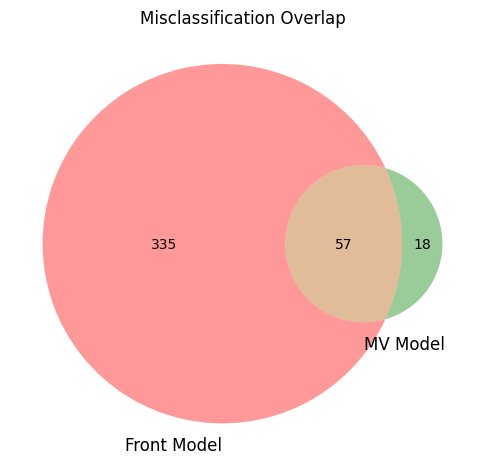

Overlap on Scan ID: 57
Total eval1: 392 Total eval2: 75


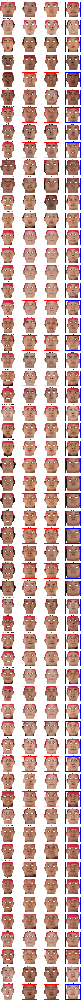

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib_venn import venn2
from pathlib import Path
from PIL import Image
import glob
from matplotlib.patches import Rectangle

# Paths
path = "F:\\Face\\HM_IDENT_3DFR\\log\\mlruns\\323213746226148507\\a37a57e18d2a45c18e9f855aea178086\\"
csv2_path = path+"artifacts\\error_rate_per_class\\test_rgb_bff_crop_mv_misclassified_scans.csv"
csv1_path = path+"artifacts\\error_rate_per_class\\test_rgb_bff_crop_front_misclassified_scans.csv"
dataset_folder = Path("F:\\Face\\data\\datasets9\\test_rgb_bff_crop")

ncols = 4  # One row per mismatched evaluation

# Load both evaluations
df1 = pd.read_csv(csv1_path)
df2 = pd.read_csv(csv2_path)

# Standardize the key columns
for df in [df1, df2]:
    df["Scan ID"] = df["Scan ID"].astype(str).str.strip()
    df["True Class"] = df["True Class"].astype(str).str.strip()
    df["Predicted Class"] = df["Predicted Class"].astype(str).str.strip()


# Get sets of misclassified IDs
wrong1 = set(df1[df1["True Class"] != df1["Predicted Class"]]["Scan ID"])
wrong2 = set(df2[df2["True Class"] != df2["Predicted Class"]]["Scan ID"])

plt.figure(figsize=(6,6))
venn2([wrong1, wrong2], set_labels=("Front Model", "MV Model"))
plt.title("Misclassification Overlap")
plt.show()

# Merge by Scan ID
merged_df = pd.merge(df1, df2, on="Scan ID", suffixes=('_1', '_2'))
# Optional: Check which ones overlap at all
print("Overlap on Scan ID:", len(merged_df))
print("Total eval1:", len(df1), "Total eval2:", len(df2))

n_images = len(df)
nrows = (n_images + 1) // 1 
plt.figure(figsize=(ncols * 5, nrows * 4))

for i, row in merged_df.head(100).iterrows():
    scan_id = row["Scan ID"]
    true_class = row["True Class_1"]
    pred1 = row["Predicted Class_1"]
    pred2 = row["Predicted Class_2"]

    try:
        query_path = dataset_folder / "validation" / str(true_class) / f"{scan_id}0_0_image.jpg"
        pred1_folder = dataset_folder / "train" / str(pred1)
        pred2_folder = dataset_folder / "train" / str(pred2)
        true_folder = dataset_folder / "train" / str(true_class)

        # Pick one image per class
        pred1_img = glob.glob(str(pred1_folder / "*0_0_image.jpg"))[0]
        pred2_img = glob.glob(str(pred2_folder / "*0_0_image.jpg"))[0]
        true_img = glob.glob(str(true_folder / "*0_0_image.jpg"))[0]

        # 1. Query image
        img_q = Image.open(query_path)
        ax1 = plt.subplot(nrows, ncols, i * ncols + 1)
        ax1.imshow(img_q)
        ax1.axis('off')
        ax1.set_title(f"Query\nID: {scan_id}\nTrue: {true_class}", fontsize=8)

        # 2. Prediction 1
        img_pred1 = Image.open(pred1_img)
        ax2 = plt.subplot(nrows, ncols, i * ncols + 2)
        ax2.imshow(img_pred1)
        ax2.axis('off')
        color1 = 'green' if pred1 == true_class else 'red'
        ax2.set_title(f"Front Model \nPred: {pred1}", fontsize=8)
        ax2.add_patch(Rectangle((0, 0), img_pred1.size[0], img_pred1.size[1], linewidth=6, edgecolor=color1, facecolor='none'))

        # 3. Prediction 2
        img_pred2 = Image.open(pred2_img)
        ax3 = plt.subplot(nrows, ncols, i * ncols + 3)
        ax3.imshow(img_pred2)
        ax3.axis('off')
        color2 = 'green' if pred2 == true_class else 'red'
        ax3.set_title(f"MV Model \nPred: {pred2}", fontsize=8)
        ax3.add_patch(Rectangle((0, 0), img_pred2.size[0], img_pred2.size[1], linewidth=6, edgecolor=color2, facecolor='none'))

        # 3. Truth
        img_correct = Image.open(true_img)
        ax4 = plt.subplot(nrows, ncols, i * ncols + 4)
        ax4.imshow(img_correct)
        ax4.axis('off')
        ax4.set_title(f"True Class\n{true_class}", fontsize=8)
        ax4.add_patch(Rectangle((0, 0), img_correct.size[0], img_correct.size[1], linewidth=6, edgecolor='blue', facecolor='none'))



    except Exception as e:
        print(f"Error loading image for Scan ID {scan_id}: {e}")

plt.tight_layout()
plt.show()



